In [1]:
import tensorflow as tf
import numpy as np
import time
import functools
import IPython.display as display
from pathlib import Path
import random
from PIL import Image
from matplotlib import pyplot
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Restrict TensorFlow to only use the fourth GPU
        tf.config.experimental.set_visible_devices(gpus[1], 'GPU')

        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

W1119 00:52:08.543284 139788061869888 core.py:204] In /home/ccchen/anaconda3/envs/tf2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
W1119 00:52:08.544411 139788061869888 core.py:204] In /home/ccchen/anaconda3/envs/tf2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
W1119 00:52:08.545129 139788061869888 core.py:204] In /home/ccchen/anaconda3/envs/tf2/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
W1119 00:52:08.545687 139788061869888 core.py:204] In /home/ccchen/anaconda3/envs/tf2/lib/python3.6/site-

4 Physical GPUs, 1 Logical GPUs


In [2]:
def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32) # 將圖片維度變得跟 max_dim 一樣大

    img = tf.image.resize(img, new_shape)
    # in order to use CNN, add one additional dimension 
    # to the original image
    # img shape: [height, width, channel] -> [batch_size, height, width, channel]
    img = img[tf.newaxis, :]
    
    return img

In [3]:
def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

    plt.imshow(image)
    if title:
        plt.title(title)

In [4]:
def image_conv(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)
    return image

# A Neural Algorithm of Artistic Style

# Define content and style representations

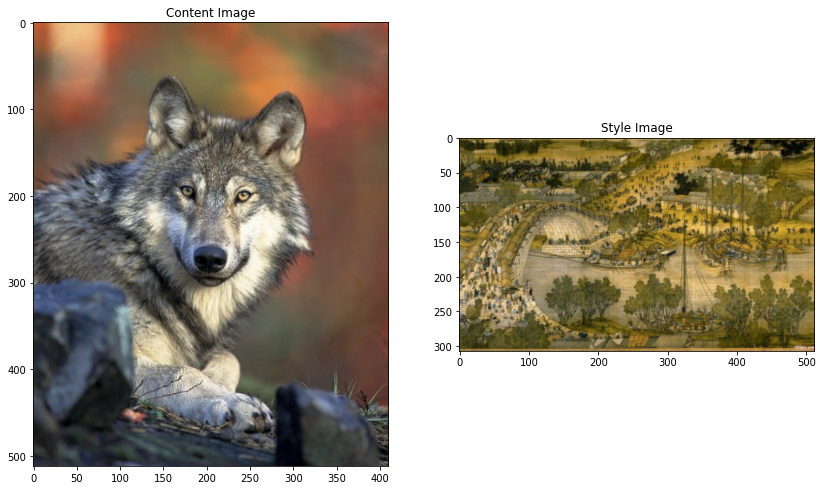

In [5]:
content_path = './dataset/image/content.jpg'
style_path = './dataset/image/style.jpg'

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.figure(figsize=(14,10))
plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [6]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
    print(layer.name)


input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [7]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer of interest
style_layers = ['block1_conv2',
                'block2_conv2',
                'block3_conv3', 
                'block4_conv3', 
                'block5_conv3']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Build the model

In [8]:
'''
https://ithelp.ithome.com.tw/articles/10190971
'''
def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model  

In [9]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
    print(name)
    print("  shape: ", output.numpy().shape)
    print("  min: ", output.numpy().min())
    print("  max: ", output.numpy().max())
    print("  mean: ", output.numpy().mean())
    print()

block1_conv2
  shape:  (1, 307, 512, 64)
  min:  0.0
  max:  2223.1611
  mean:  145.12068

block2_conv2
  shape:  (1, 153, 256, 128)
  min:  0.0
  max:  5019.421
  mean:  139.25706

block3_conv3
  shape:  (1, 76, 128, 256)
  min:  0.0
  max:  5124.5723
  mean:  391.1989

block4_conv3
  shape:  (1, 38, 64, 512)
  min:  0.0
  max:  7185.7803
  mean:  163.62935

block5_conv3
  shape:  (1, 19, 32, 512)
  min:  0.0
  max:  313.73328
  mean:  6.3350067



# Calculate style

In [10]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

# Extract style and content

In [11]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg =  vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name:value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}

In [12]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

style_results = results['style']

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

Styles:
   block1_conv2
    shape:  (1, 64, 64)
    min:  61.957245
    max:  165906.84
    mean:  4952.7676

   block2_conv2
    shape:  (1, 128, 128)
    min:  0.008549741
    max:  92837.62
    mean:  6444.6504

   block3_conv3
    shape:  (1, 256, 256)
    min:  971.8246
    max:  549927.7
    mean:  60633.164

   block4_conv3
    shape:  (1, 512, 512)
    min:  0.0
    max:  417855.12
    mean:  19687.504

   block5_conv3
    shape:  (1, 512, 512)
    min:  0.0
    max:  17970.318
    mean:  93.47651

Contents:
   block5_conv4
    shape:  (1, 32, 25, 512)
    min:  0.0
    max:  348.1569
    mean:  1.1570885


# Define loss

In [13]:
def style_content_loss(outputs, style_weight, content_weight):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

# Run gradient descent

In [14]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [15]:
# @tf.function()
def train_step(image, style_weight, content_weight, opt):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs, style_weight, content_weight)

    # tape.gradient: d_loss/d_image
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

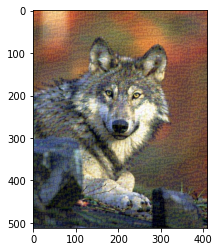

In [16]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

image_0 = tf.Variable(content_image)
opt_0 = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1, name="first")

train_step(image_0, 1, 10, opt_0)
train_step(image_0, 1, 10, opt_0)
train_step(image_0, 1, 10, opt_0)
plt.imshow(image_0.read_value()[0])

# TODO: Change the weights for the style, content, and total variational loss

As the following results, the larger style weight, the stronger style is. In contrast, the larger content weight, the clearer content is. There is an interesting thing that if the weight is smaller than 1, it almost doesn't affect the result no matter how large/small the weight is. Once the weight > 1, it affect the image significantly.

However, it seems that style weight affect the image more significantly. For the same value of content and style weight, the image would become smoother(unclearer). 

In [17]:
style_weights = [1e-3, 1, 1000, 100000]
content_weights = [1e-3, 1, 1000, 100000]

Style Weight: 0.001, Content Weight: 0.001


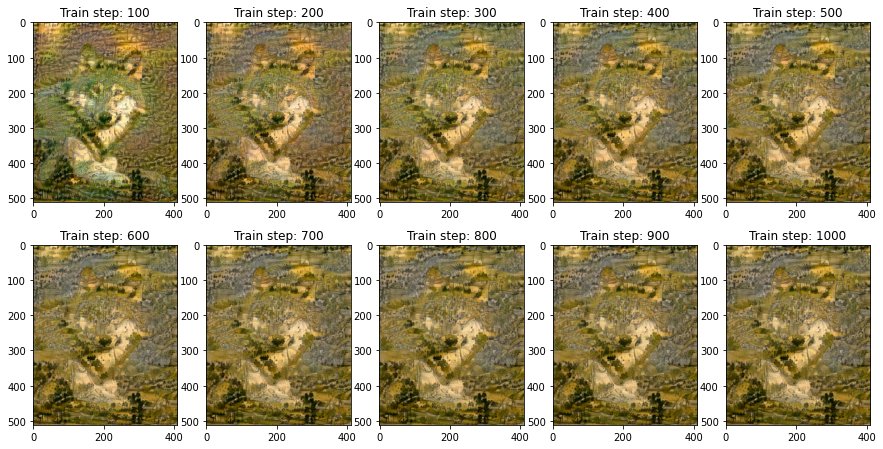

Total time: 65.9
Style Weight: 0.001, Content Weight: 1


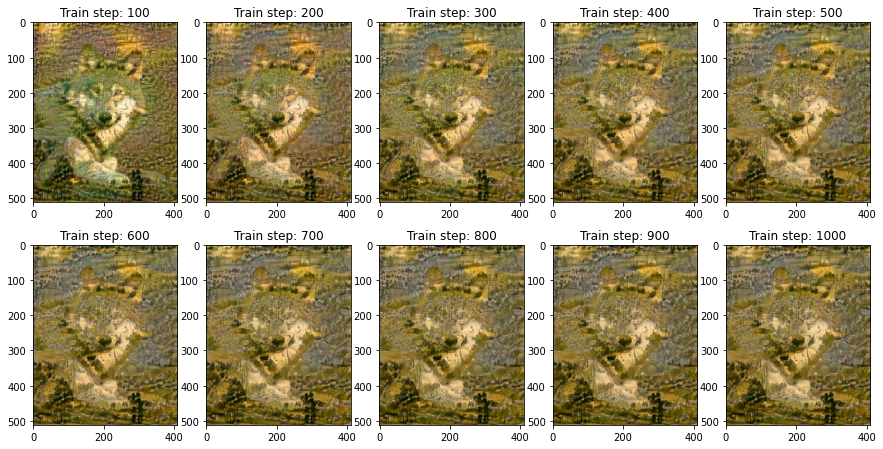

Total time: 68.1
Style Weight: 0.001, Content Weight: 1000


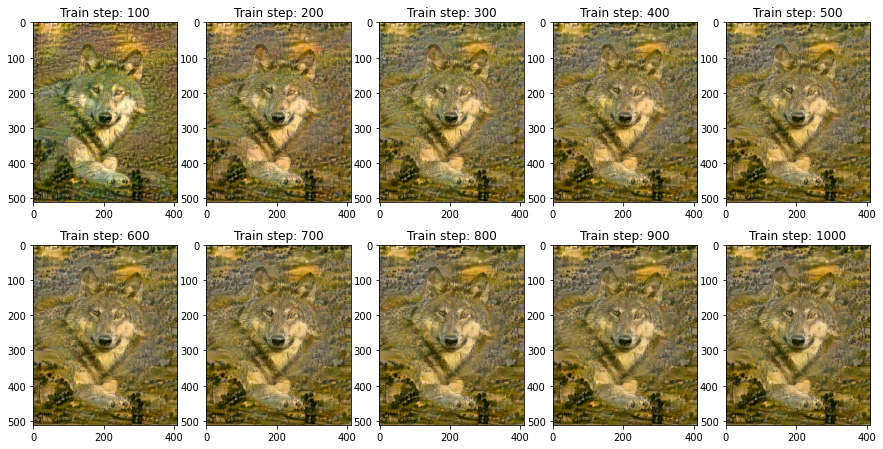

Total time: 68.2
Style Weight: 0.001, Content Weight: 100000


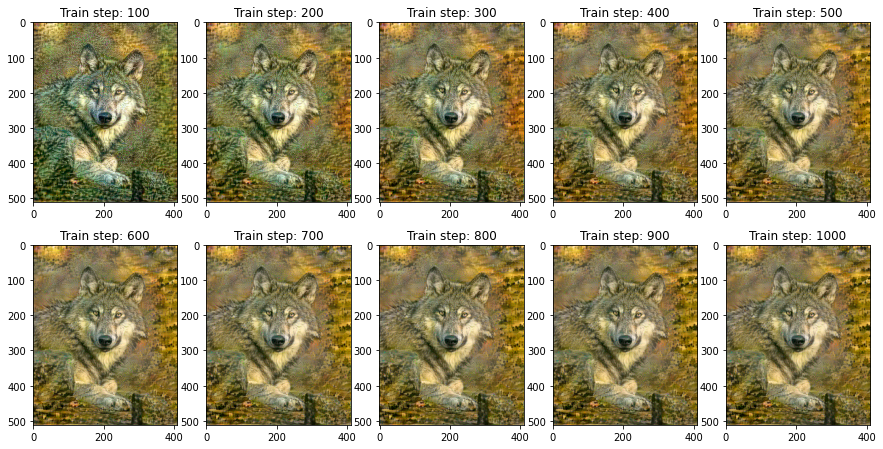

Total time: 68.0
Style Weight: 1, Content Weight: 0.001


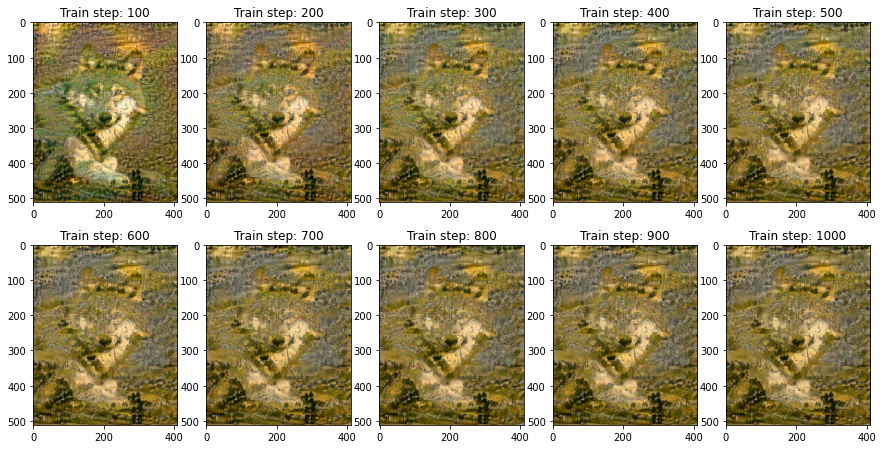

Total time: 67.4
Style Weight: 1, Content Weight: 1


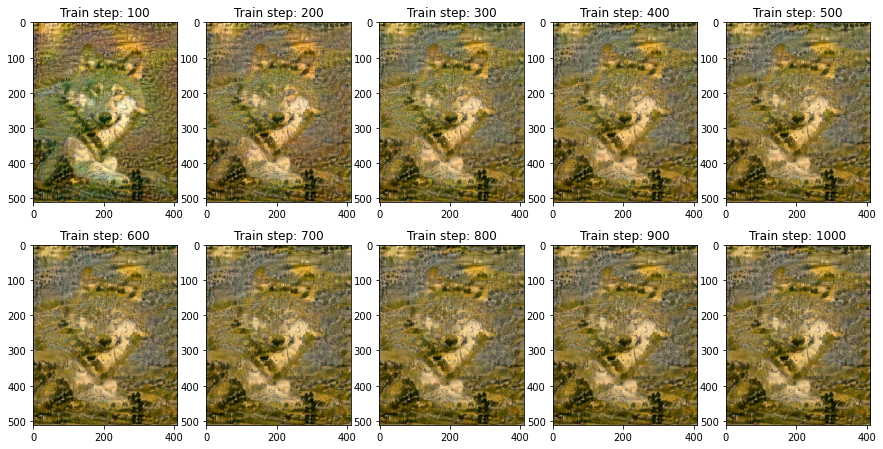

Total time: 67.4
Style Weight: 1, Content Weight: 1000


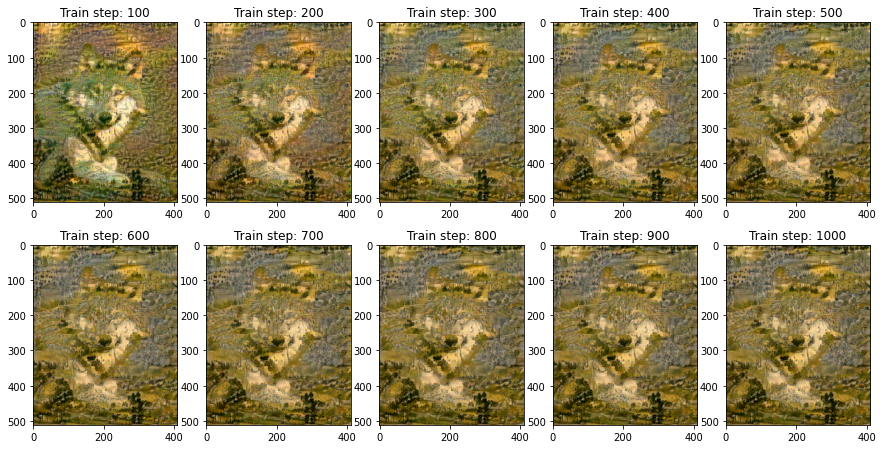

Total time: 67.7
Style Weight: 1, Content Weight: 100000


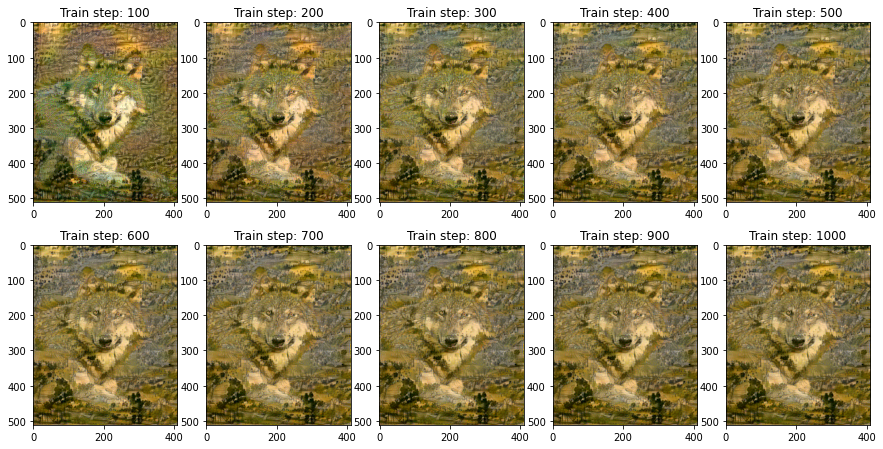

Total time: 67.5
Style Weight: 1000, Content Weight: 0.001


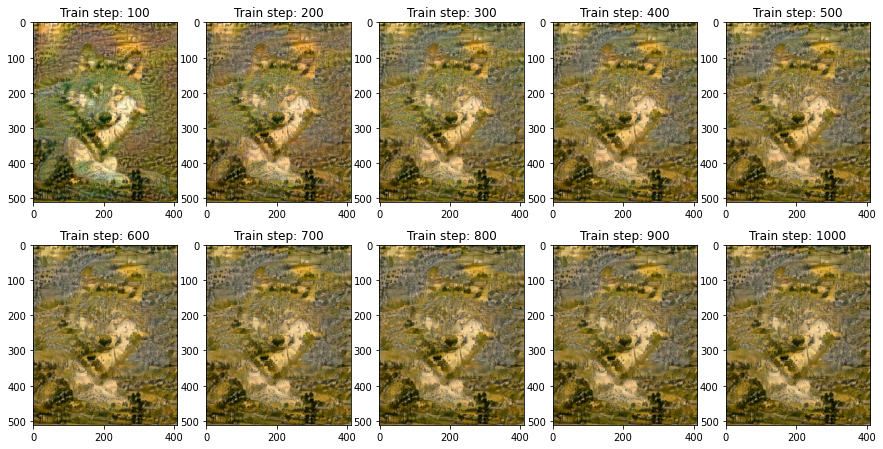

Total time: 67.4
Style Weight: 1000, Content Weight: 1


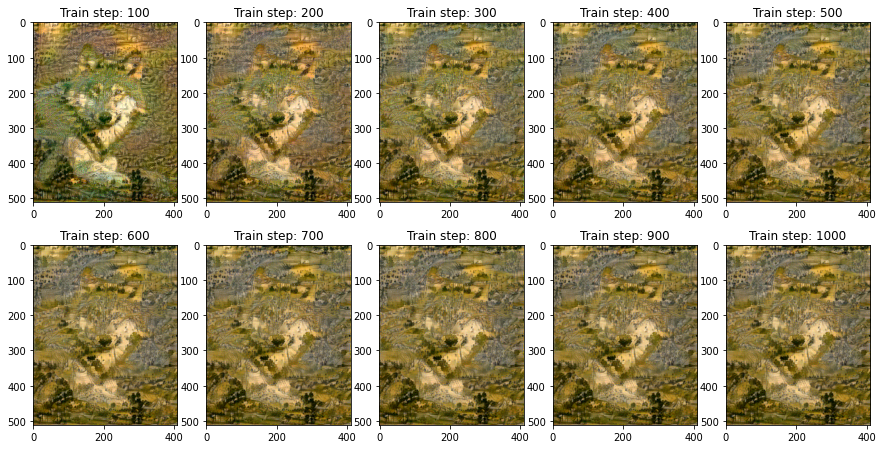

Total time: 67.3
Style Weight: 1000, Content Weight: 1000


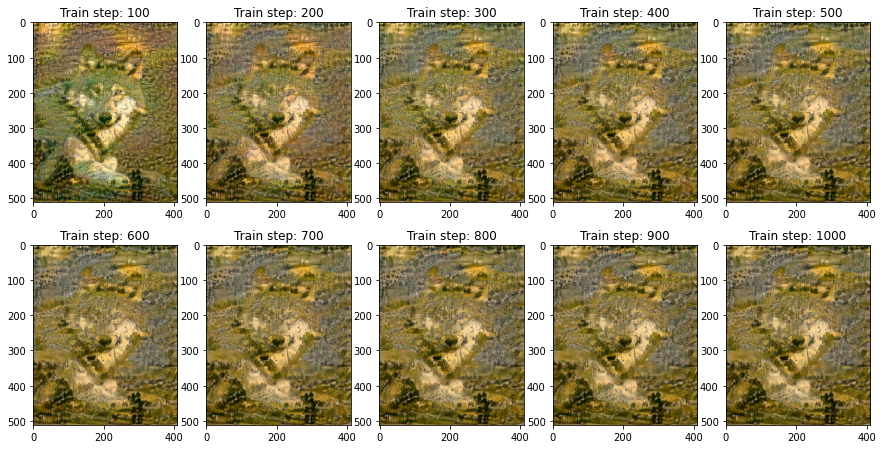

Total time: 67.5
Style Weight: 1000, Content Weight: 100000


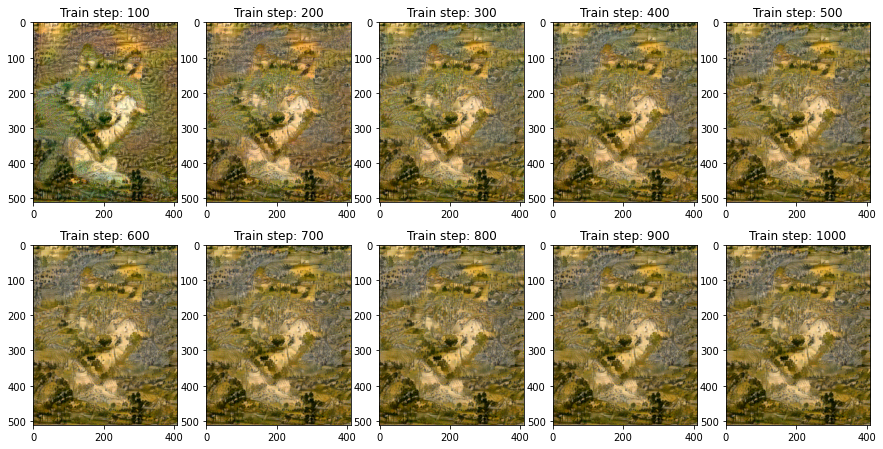

Total time: 67.5
Style Weight: 100000, Content Weight: 0.001


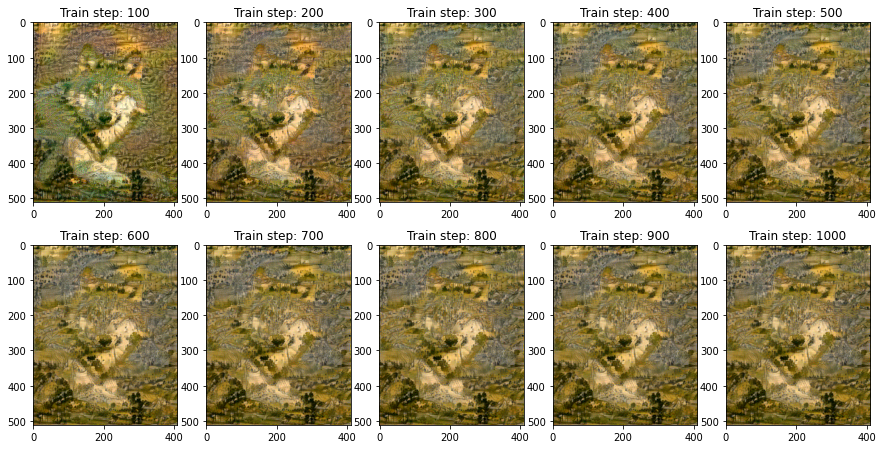

Total time: 67.4
Style Weight: 100000, Content Weight: 1


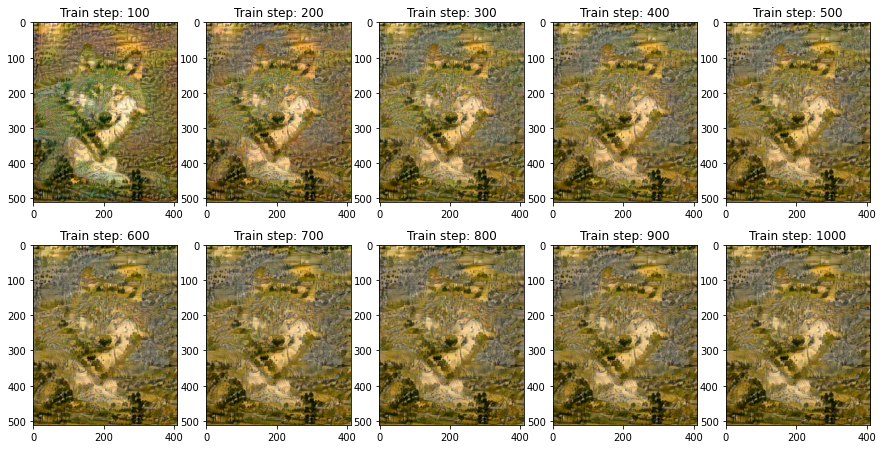

Total time: 67.3
Style Weight: 100000, Content Weight: 1000


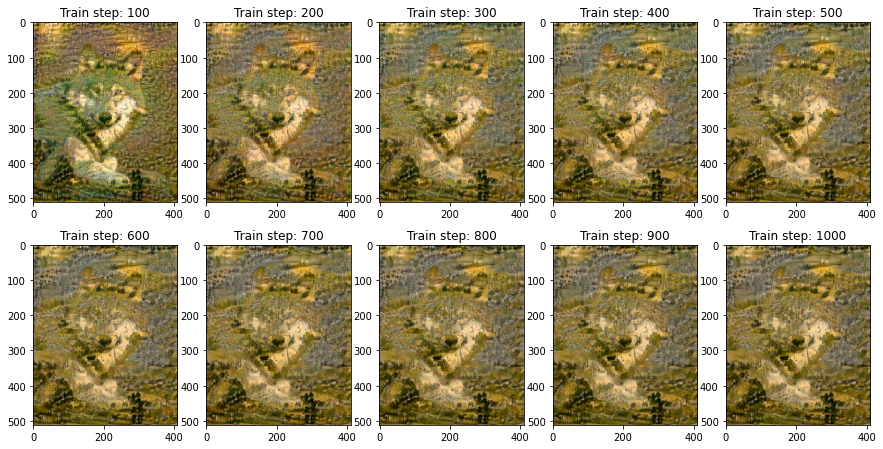

Total time: 67.6
Style Weight: 100000, Content Weight: 100000


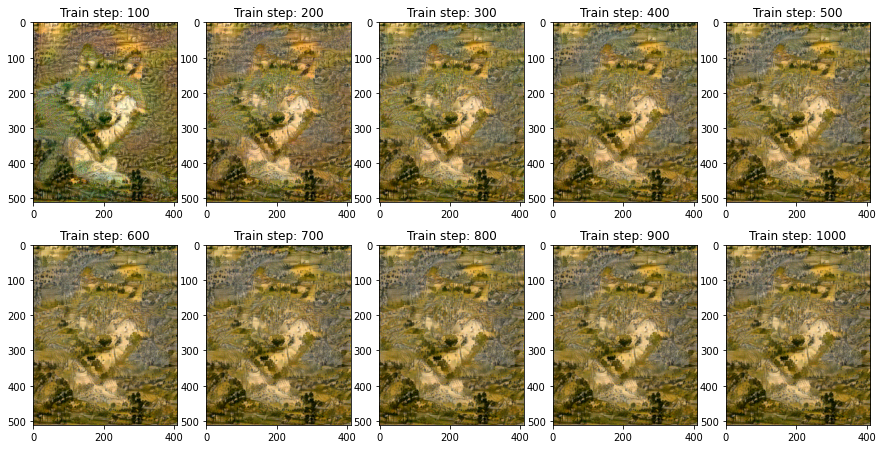

Total time: 67.3


In [18]:
import time

epochs = 10
steps_per_epoch = 100

count = 0

for s_w in style_weights:
    for c_w in content_weights:        
        start = time.time()
        step = 0
        fig, axs = plt.subplots(2, epochs//2, figsize=(15, 7.5))
        
        content_image_l = load_img(content_path)
        image_l = tf.Variable(content_image_l)
        opt_l = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
        
        print(f"Style Weight: {s_w}, Content Weight: {c_w}")
        for n in range(epochs):
            for m in range(steps_per_epoch):
                step += 1
                train_step(image_l, s_w, c_w, opt_l)
            axs[n // (epochs//2)][n % (epochs//2)].imshow(image_conv(image_l.read_value()))
            axs[n // (epochs//2)][n % (epochs//2)].set_title("Train step: {}".format(step))
#             print(f"Epoch {n} Step {m}")
        plt.show()
        file_name = f'./dataset/image/style_wolf_sw{s_w}_cw{c_w}.png'
        mpl.image.imsave(file_name, image_l[0].numpy())

        end = time.time()
        print("Total time: {:.1f}".format(end-start))

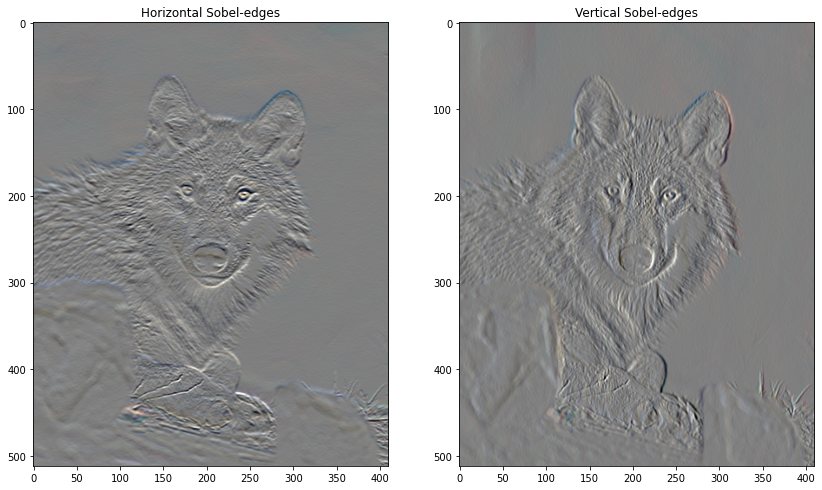

In [19]:
plt.figure(figsize=(14,10))

sobel = tf.image.sobel_edges(content_image)
plt.subplot(1,2,1)
imshow(clip_0_1(sobel[...,0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1,2,2)
imshow(clip_0_1(sobel[...,1]/4+0.5), "Vertical Sobel-edges")

# Total variation loss

# TODO Implement total variational loss

In [20]:
def total_variation_loss(image):
    # TODO
    x_var = image[:, :, 1:, :] - image[:, :, :-1, :]
    y_var = image[:, 1:, :, :] - image[:, :-1, :, :]
    
    return tf.reduce_sum(tf.math.abs(x_var)) + tf.reduce_sum(tf.math.abs(y_var))
    

# Re-run the optimization

# TODO: Change the Wight of Total Variation Loss
It is obvious that the larger weight of total variation loss, the edge of the wolf becomes clearer(compare to the result without total variation loss). However, once the weight of total variation loss is too large, the background would disappear.

In [ ]:
total_variation_weights = [1e-3, 1, 10, 100, 1000, 10000]
style_weight = 1
content_weight = 1

In [ ]:
# @tf.function()
def train_step(image, total_variation_weight, style_weight, content_weight, opt):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs, style_weight, content_weight)
#         print(total_variation_loss(image))
        loss += total_variation_weight*total_variation_loss(image)

    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))


Total Variation Weights: 0.001(Fixed: Style Weight: 1, Content Weight: 1)


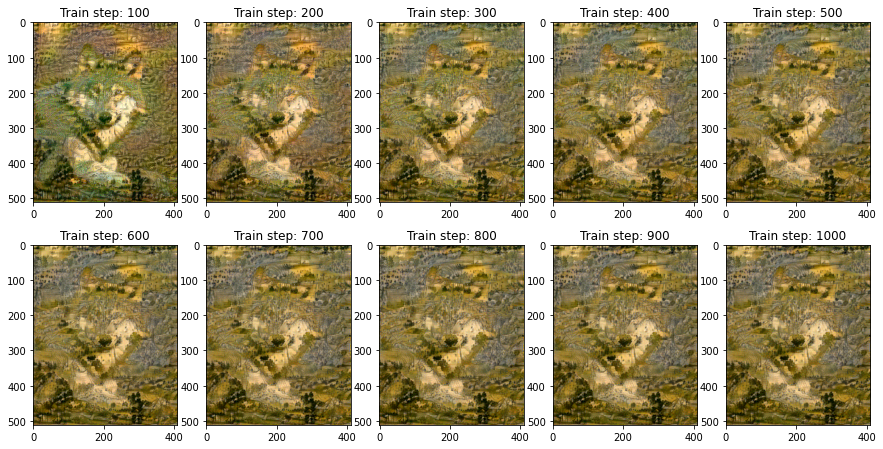

Total time: 69.3

Total Variation Weights: 1(Fixed: Style Weight: 1, Content Weight: 1)


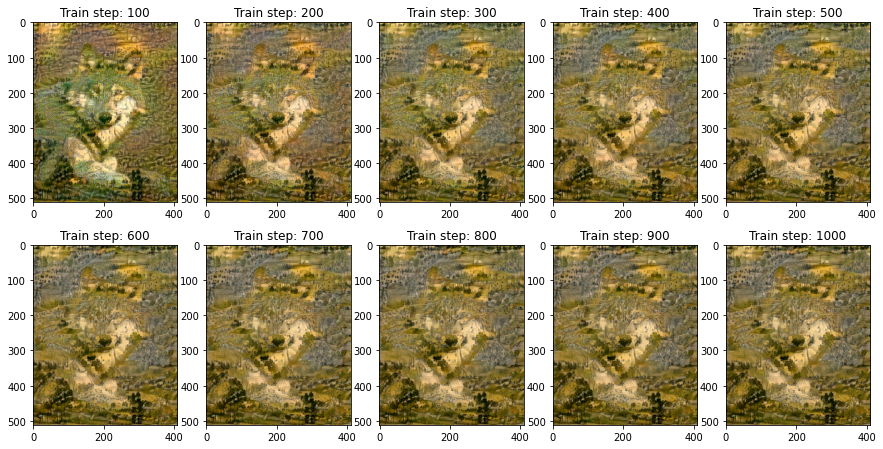

Total time: 69.3

Total Variation Weights: 10(Fixed: Style Weight: 1, Content Weight: 1)


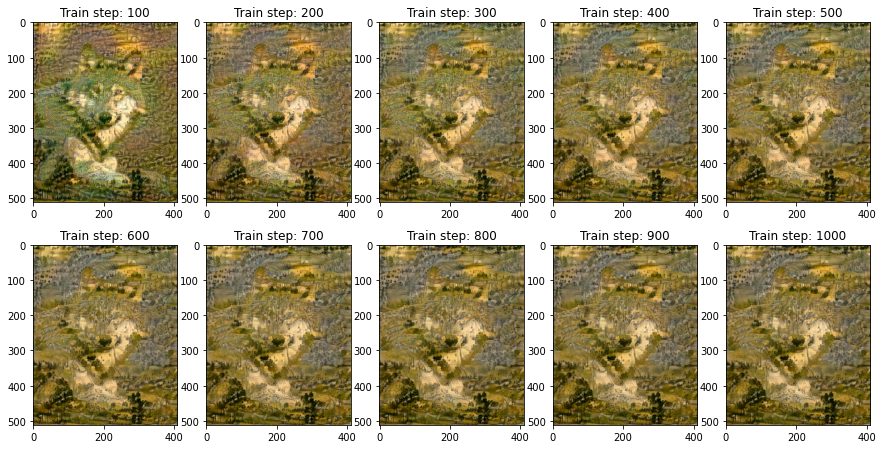

Total time: 69.5

Total Variation Weights: 100(Fixed: Style Weight: 1, Content Weight: 1)


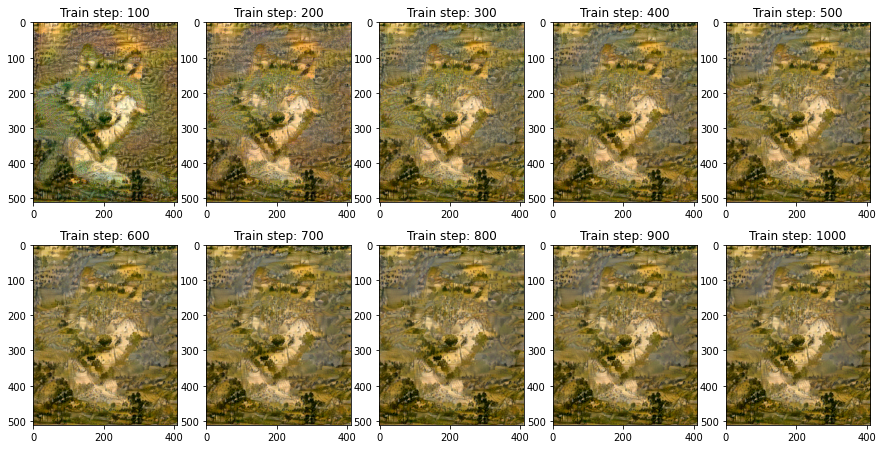

Total time: 69.3

Total Variation Weights: 1000(Fixed: Style Weight: 1, Content Weight: 1)


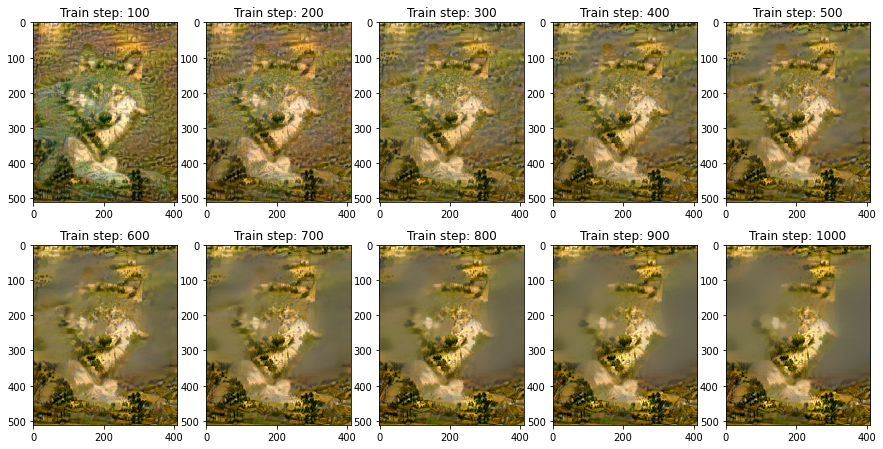

Total time: 69.2

Total Variation Weights: 10000(Fixed: Style Weight: 1, Content Weight: 1)


In [ ]:
for t_v_w in total_variation_weights:    
    start = time.time()

    epochs = 10
    steps_per_epoch = 100
    
    fig, axs = plt.subplots(2, epochs//2, figsize=(15, 7.5))
        
    content_image_l = load_img(content_path)
    image_l = tf.Variable(content_image_l)
    opt_l = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

    step = 0
    print(f"")
    print(f"Total Variation Weights: {t_v_w}(Fixed: Style Weight: {style_weight}, Content Weight: {content_weight})")
    for n in range(epochs):
        for m in range(steps_per_epoch):
            step += 1
            train_step(image_l, t_v_w, style_weight, content_weight, opt_l)
            
#         imshow(image_l.read_value())
        axs[n // (epochs//2)][n % (epochs//2)].imshow(image_conv(image_l.read_value()))
        axs[n // (epochs//2)][n % (epochs//2)].set_title("Train step: {}".format(step))
    plt.show()
    file_name = f'./dataset/image/style_wolf_tvw{t_v_w}.png'
    mpl.image.imsave(file_name, image_l[0].numpy())
#         plt.title("Train step: {}".format(step))
#         plt.show()

    end = time.time()
    print("Total time: {:.1f}".format(end-start))

# TODO: Use Other layers
# Use Shallow Layers for Style
Here I change the content and style layers to shallower layers. As the following result, the image become clearer. I think becasue the shallower layers keep morelower-level features such as edge, corner..., it can represent more detail of the original image.

In [ ]:
# Content layer where will pull our feature maps
content_layers = ['block1_conv2'] 

# Style layer of interest
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

extractor = StyleContentModel(style_layers, content_layers)
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

In [ ]:
results = extractor(tf.constant(content_image))

style_results = results['style']

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

In [26]:
def style_content_loss(outputs, style_weight, content_weight):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

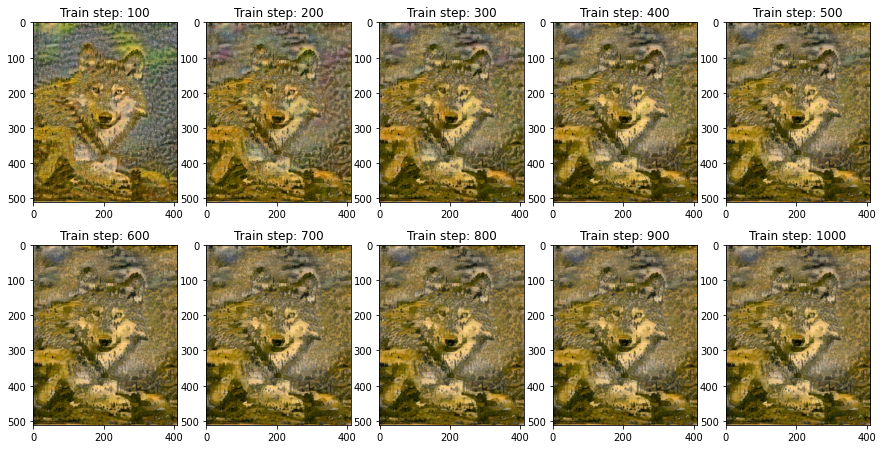

Total time: 46.2

Total Variation Weights: 10(Fixed: Style Weight: 1, Content Weight: 1)


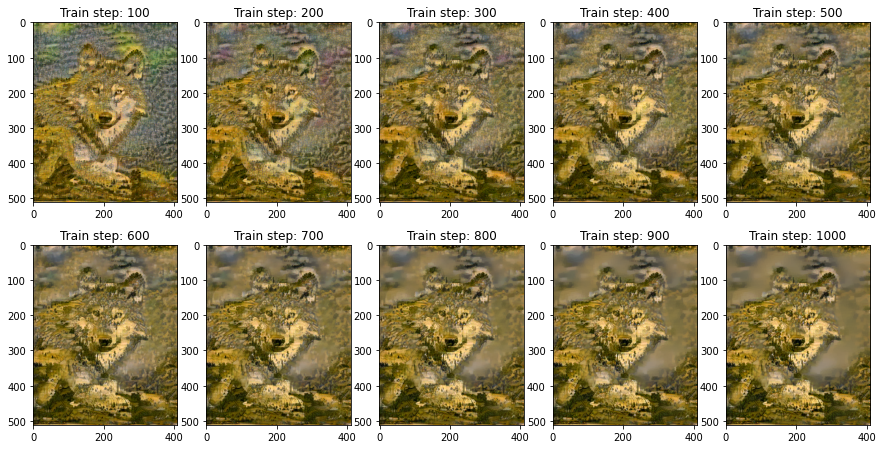

Total time: 45.8

Total Variation Weights: 100(Fixed: Style Weight: 1, Content Weight: 1)


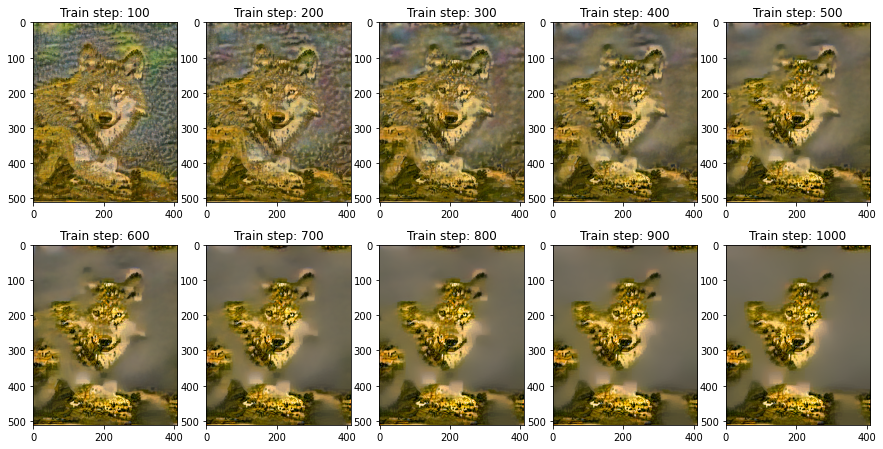

Total time: 45.4


In [27]:
total_variation_weights = [1e-3, 1, 10, 100]
for t_v_w in total_variation_weights:    
    start = time.time()

    epochs = 10
    steps_per_epoch = 100
    
    fig, axs = plt.subplots(2, epochs//2, figsize=(15, 7.5))
        
    content_image_l = load_img(content_path)
    image_l = tf.Variable(content_image_l)
    opt_l = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

    step = 0
    print(f"")
    print(f"Total Variation Weights: {t_v_w}(Fixed: Style Weight: {style_weight}, Content Weight: {content_weight})")
    for n in range(epochs):
        for m in range(steps_per_epoch):
            step += 1
            train_step(image_l, t_v_w, style_weight, content_weight, opt_l)
            
#         imshow(image_l.read_value())
        axs[n // (epochs//2)][n % (epochs//2)].imshow(image_conv(image_l.read_value()))
        axs[n // (epochs//2)][n % (epochs//2)].set_title("Train step: {}".format(step))
    plt.show()
    file_name = f'./dataset/image/style_wolf_sl_tvw{t_v_w}.png'
    mpl.image.imsave(file_name, image_l[0].numpy())
#         plt.title("Train step: {}".format(step))
#         plt.show()

    end = time.time()
    print("Total time: {:.1f}".format(end-start))

# AdaIN



In [28]:
%matplotlib inline

CONTENT_DIRS = ['/mnt/large-disk/sychou/lab12-2/test2014']
STYLE_DIRS = ['/mnt/large-disk/sychou/lab12-2/test']

# VGG19 was trained by Caffe which converted images from RGB to BGR,
# then zero-centered each color channel with respect to the ImageNet 
# dataset, without scaling.  
IMG_MEANS = np.array([103.939, 116.779, 123.68]) # BGR

IMG_SHAPE = (224, 224, 3) # training image shape, (h, w, c)
SHUFFLE_BUFFER = 1000
BATCH_SIZE = 16
EPOCHS = 30
STEPS_PER_EPOCH = 12000 // BATCH_SIZE

Sampled content images:


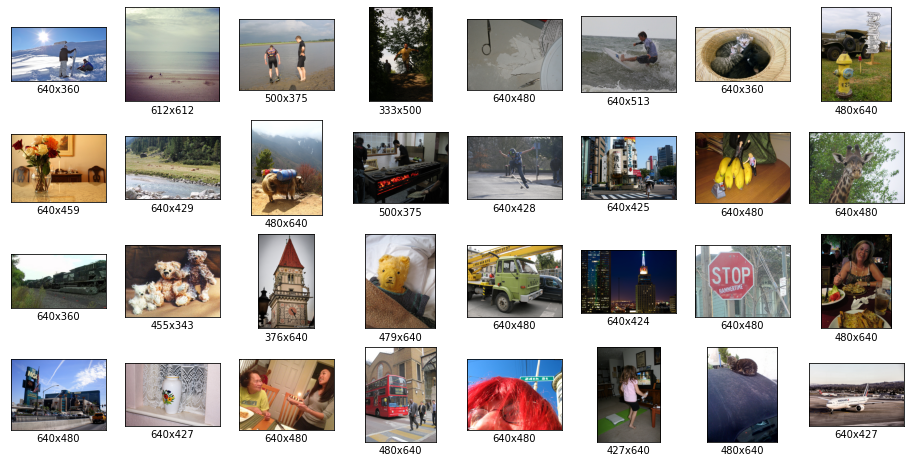

Sampled style images:


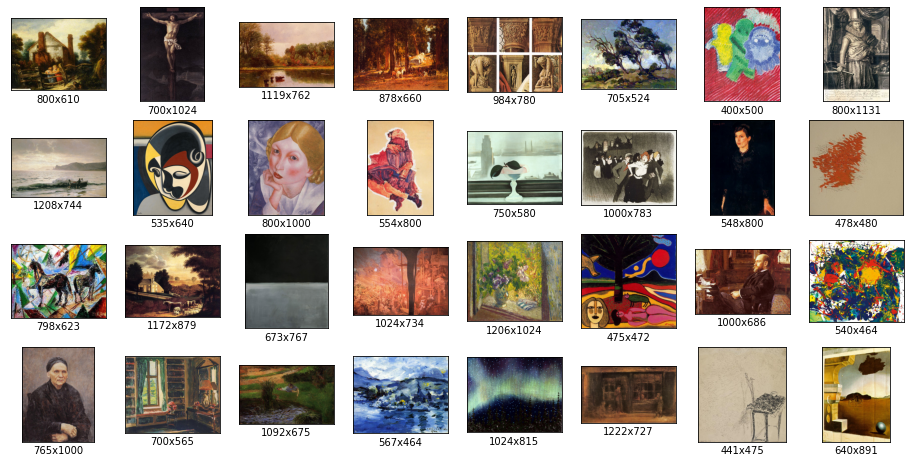

In [29]:
def sample_files(dir, num, pattern='**/*.jpg'):
    '''Samples files in a directory using the reservoir sampling.'''

    paths = Path(dir).glob(pattern) # list of Path objects
    sampled = []
    for i, path in enumerate(paths):
        if i < num:
            sampled.append(path) 
        else:
            s = random.randint(0, i)
            if s < num:
                sampled[s] = path
    return sampled

def plot_images(dir, row, col, pattern):
    paths = sample_files(dir, row*col, pattern)

    plt.figure(figsize=(2*col, 2*row))
    for i in range(row*col):
        im = Image.open(paths[i])
        w, h = im.size

        plt.subplot(row, col, i+1)
        plt.imshow(im)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.xlabel(f'{w}x{h}')
    plt.show()

print('Sampled content images:')
plot_images(CONTENT_DIRS[0], 4, 8, pattern='*.jpg')

print('Sampled style images:')
plot_images(STYLE_DIRS[0], 4, 8, pattern='*.jpg')

# Dataset API

In [30]:
def clean(dir_path, min_shape=None):
    paths = Path(dir_path).glob('**/*.jpg')
    deleted  = 0
    for path in paths:
        try:
            # Make sure we can decode the image
            im = tf.io.read_file(str(path.resolve()))
            im = tf.image.decode_jpeg(im)

            # Remove grayscale images 
            shape = im.shape
            if shape[2] < 3:
                path.unlink()
                deleted += 1

            # Remove small images
            if min_shape is not None:
                if shape[0] < min_shape[0] or shape[1] < min_shape[1]:
                    path.unlink()
                    deleted += 1
        except Exception as e:
            path.unlink()
            deleted += 1
    return deleted

for dir in CONTENT_DIRS:
    deleted = clean(dir)
print(f'#Deleted content images: {deleted}')

for dir in STYLE_DIRS:
    deleted = clean(dir)
print(f'#Deleted style images: {deleted}')

#Deleted content images: 0
#Deleted style images: 0


In [31]:
def preprocess_image(path, init_shape=(448, 448)):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.image.random_crop(image, size=IMG_SHAPE)
    image = tf.cast(image, tf.float32)
    
    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def np_image(image):
    image += (103.939, 116.779, 123.68) # BGR means
    image = image[..., ::-1] # BGR to RGB
    image = tf.clip_by_value(image, 0, 255)
    image = tf.cast(image, dtype='uint8')
    return image.numpy()

def build_dataset(num_gpus=1):
    c_paths = []
    for c_dir in CONTENT_DIRS:
        c_paths += Path(c_dir).glob('*.jpg')
    c_paths = [str(path.resolve()) for path in c_paths]
    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')

    AUTOTUNE = tf.data.experimental.AUTOTUNE

    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)

    print('done')
    return ds

Building dataset from 40,736 content images and 23,585 style images... done
Content batch shape: (16, 224, 224, 3)
Style batch shape: (16, 224, 224, 3)


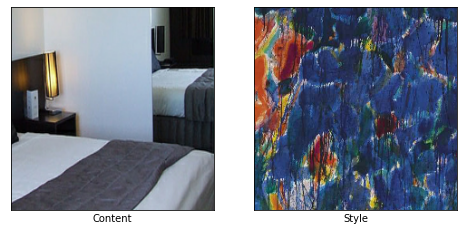

In [32]:
ds = build_dataset()
c_batch, s_batch = next(iter(ds.take(1)))

print('Content batch shape:', c_batch.shape)
print('Style batch shape:', s_batch.shape)

plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(np_image(c_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Content')

plt.subplot(1, 2, 2)
plt.imshow(np_image(s_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Style')

plt.show()

# Adaptive Instance Normalization(AdaIN)

# TODO: AdaIN

Here I change the standard deviation of the content to the variance of the content otherwise it wouldn't work.

In [33]:
class AdaIN(tf.keras.layers.Layer):
    def __init__(self, name=None):
        super(AdaIN, self).__init__()
        self.epsilon = 1e-3
        
    def call(self, feats):
        content_feats, style_feats = feats
        
        content_mean, content_var = tf.nn.moments(content_feats, [1, 2], keepdims=True)
        style_mean, style_var = tf.nn.moments(style_feats, [1, 2], keepdims=True)
        
        return tf.nn.batch_normalization(content_feats, content_mean, content_var, style_mean, tf.sqrt(style_var), 1e-9)

# Model

In [34]:
class ArbitraryStyleTransferNet(tf.keras.Model):
    CONTENT_LAYER = 'block4_conv1'
    STYLE_LAYERS = ('block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1')

    @staticmethod
    def declare_decoder():
        a_input = tf.keras.Input(shape=(28, 28, 512), name='input_adain')

        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(a_input)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        output = tf.keras.layers.Conv2DTranspose(3, 3, padding='same')(h)

        return tf.keras.Model(inputs=a_input, outputs=output, name='decoder')
  
    def __init__(self,
                 img_shape=(224, 224, 3),
                 content_loss_weight=1,
                 style_loss_weight=10,
                 name='arbitrary_style_transfer_net',
                 **kwargs):
        super(ArbitraryStyleTransferNet, self).__init__(name=name, **kwargs)

        self.img_shape = img_shape
        self.content_loss_weight = content_loss_weight
        self.style_loss_weight = style_loss_weight
        
        vgg19 = tf.keras.applications.VGG19(include_top=False, weights='imagenet', input_shape=img_shape)
        vgg19.trainable = False

        c_output = [vgg19.get_layer(ArbitraryStyleTransferNet.CONTENT_LAYER).output]
        s_outputs = [vgg19.get_layer(name).output for name in ArbitraryStyleTransferNet.STYLE_LAYERS]
        self.vgg19 = tf.keras.Model(inputs=vgg19.input, outputs=c_output+s_outputs, name='vgg19')
        self.vgg19.trainable = False

        self.adain = AdaIN(name='adain')
        self.decoder = ArbitraryStyleTransferNet.declare_decoder()
  
    def call(self, inputs):
        c_batch, s_batch = inputs

        c_enc = self.vgg19(c_batch)
        c_enc_c = c_enc[0]

        s_enc = self.vgg19(s_batch)
        s_enc_c = s_enc[0]
        s_enc_s = s_enc[1:] 
        
        # normalized_c is the output of AdaIN layer
        normalized_c = self.adain((c_enc_c, s_enc_c))
        output = self.decoder(normalized_c)

        # Calculate loss
        out_enc = self.vgg19(output)
        out_enc_c = out_enc[0]
        out_enc_s = out_enc[1:]

        loss_c = tf.reduce_mean(tf.math.squared_difference(out_enc_c, normalized_c))
        self.add_loss(self.content_loss_weight * loss_c)
        
        loss_s = 0
        for o, s in zip(out_enc_s, s_enc_s):    
            o_mean, o_var = tf.nn.moments(o, axes=(1,2), keepdims=True)
            o_std = tf.sqrt(o_var + self.adain.epsilon)

            s_mean, s_var = tf.nn.moments(s, axes=(1,2), keepdims=True)
            s_std = tf.sqrt(s_var + self.adain.epsilon)

            loss_mean = tf.reduce_mean(tf.math.squared_difference(o_mean, s_mean))
            loss_std = tf.reduce_mean(tf.math.squared_difference(o_std, s_std))

            loss_s += loss_mean + loss_std
        self.add_loss(self.style_loss_weight * loss_s)

        return output, c_enc_c, normalized_c, out_enc_c

In [35]:
# Plot results
def plot_outputs(outputs, captions=None, col=5):
    row = len(outputs)
    plt.figure(figsize=(3*col, 3*row))
    for i in range(col):
        for j in range(row):
            plt.subplot(row, col, j*col+i+1)
            plt.imshow(np_image(outputs[j][i,...,:3]))
            plt.grid(False)
            plt.xticks([])
            plt.yticks([])
            if captions is not None:
                plt.xlabel(captions[j])
    plt.show()

In [36]:
ds = build_dataset()
model = ArbitraryStyleTransferNet(img_shape=IMG_SHAPE)

c_batch, s_batch = next(iter(ds.take(1)))
print(f'Input shape: ({c_batch.shape}, {s_batch.shape})')
output, *_ = model((c_batch, s_batch))
print(f'Output shape: {output.shape}')
print(f'Init. content loss: {model.losses[0]:,.2f}, style loss: {model.losses[1]:,.2f}')
model.summary()

Building dataset from 40,736 content images and 23,585 style images... done
Input shape: ((16, 224, 224, 3), (16, 224, 224, 3))
Output shape: (16, 224, 224, 3)
Init. content loss: 1,904,636.62, style loss: 11,294,080.00
Model: "arbitrary_style_transfer_net"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                [(None, 28, 28, 512), (No 3505728   
_________________________________________________________________
ada_in (AdaIN)               multiple                  0         
_________________________________________________________________
decoder (Model)              (None, 224, 224, 3)       3505219   
Total params: 7,010,947
Trainable params: 3,505,219
Non-trainable params: 3,505,728
_________________________________________________________________


# Training

In [37]:
import os

In [38]:
# Train the model
optimizer = tf.keras.optimizers.Adam(lr=5e-4)
c_loss_metric, s_loss_metric = tf.keras.metrics.Mean(), tf.keras.metrics.Mean()

CKP_DIR = 'checkpoints'
init_epoch = 1

ckp = tf.train.latest_checkpoint(CKP_DIR)
if ckp:
    model.load_weights(ckp)
    init_epoch = int(ckp.split('_')[-1]) + 1
    print(f'Resume training from epoch {init_epoch-1}')

Resume training from epoch 30


In [39]:
@tf.function
def train_step(inputs):
    with tf.GradientTape() as tape:
        model(inputs)
        c_loss, s_loss = model.losses
        loss = c_loss + s_loss
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

    c_loss_metric(c_loss)
    s_loss_metric(s_loss)


In [40]:
def train(dataset, init_epoch):
    for epoch in range(init_epoch, EPOCHS+1):
        print(f'Epoch {epoch:>2}/{EPOCHS}')
        for step, inputs in enumerate(ds.take(STEPS_PER_EPOCH)):
            train_step(inputs)
            print(f'{step+1:>5}/{STEPS_PER_EPOCH} - loss: {c_loss_metric.result()+s_loss_metric.result():,.2f} - content loss: {c_loss_metric.result():,.2f} - style loss: {s_loss_metric.result():,.2f}', end='\r') 

        print()
        model.save_weights(os.path.join(CKP_DIR, f'ckpt_{epoch}'))
        c_loss_metric.reset_states()
        s_loss_metric.reset_states()

        output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
        plot_outputs((s_batch, c_batch, output, c_enc_c, normalized_c, out_enc_c), 
                     ('Style', 'Content', 'Trans', 'Content Enc', 'Normalized', 'Trans Enc'))

In [41]:
train(ds, init_epoch)

# Testing

Building dataset from 40,736 content images and 23,585 style images... done
Recovered loss: 644538.75


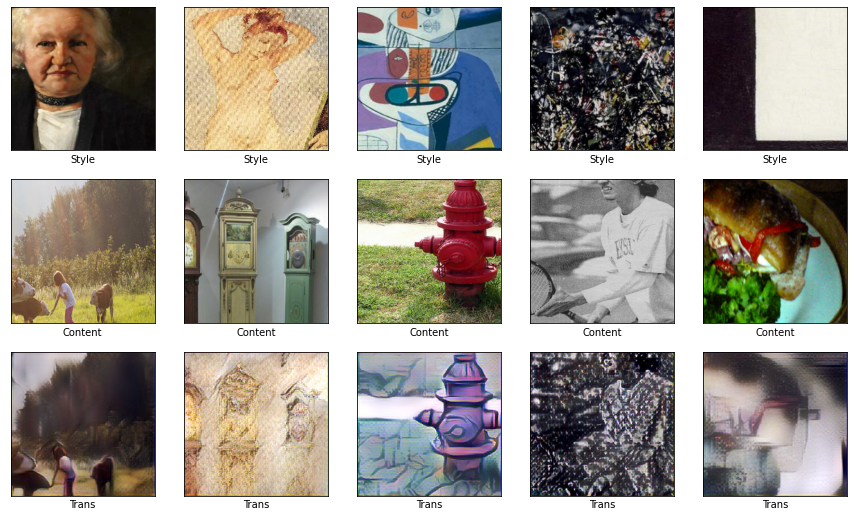

Recovered loss: 608095.94


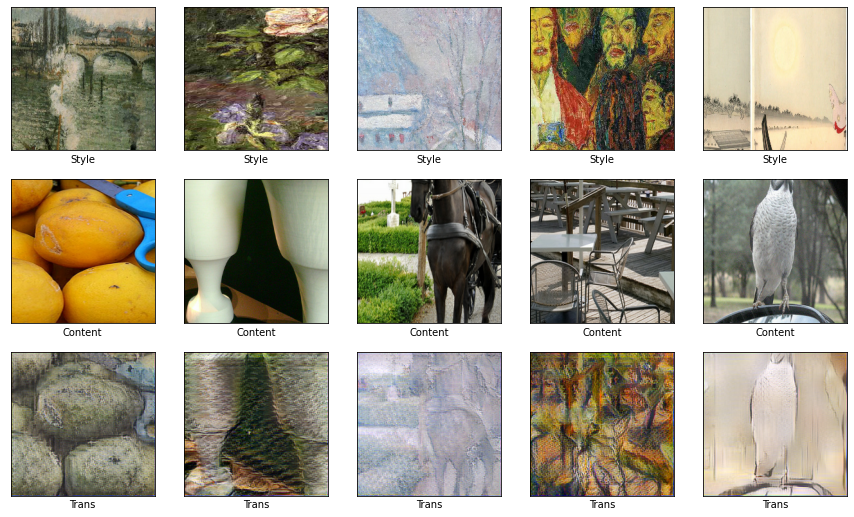

In [42]:
CKP_DIR = 'checkpoints/ckpt_20'

model = ArbitraryStyleTransferNet(img_shape=IMG_SHAPE)
model.load_weights(CKP_DIR)

ds = build_dataset()

for idx, (c_batch, s_batch) in enumerate(ds):
    if idx > 1:
        break
    output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
    print('Recovered loss:', tf.reduce_sum(model.losses).numpy())

    plot_outputs((s_batch, c_batch, output), ('Style', 'Content', 'Trans'))

# Example

In [43]:
def preprocess_example(path, init_shape=(IMG_SHAPE[0], IMG_SHAPE[1])):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.cast(image, tf.float32)
    
    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def nthu_example(num_gpus=1):
    c_paths = ['./dataset/ny_skyline.jpg']
    
    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')
    
    AUTOTUNE = tf.data.experimental.AUTOTUNE
    
    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_example, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)
    
    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)
    
    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)
    
    print('done')
    return ds

Building dataset from 1 content images and 23,585 style images... done


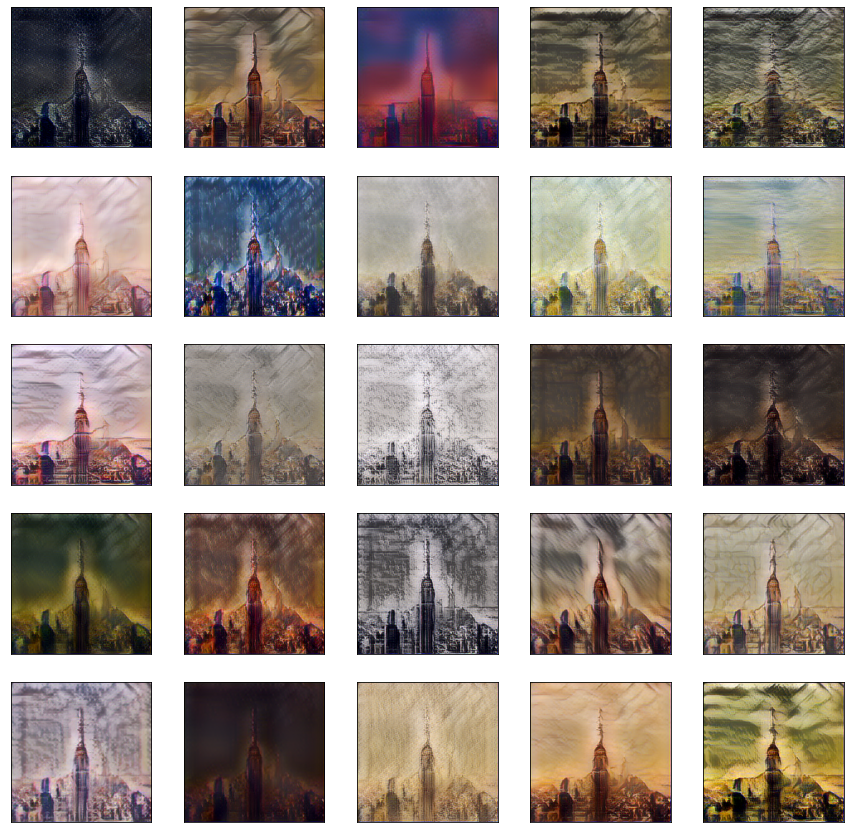

In [44]:
ds = nthu_example()
outputs = []

for idx, (c_batch, s_batch) in enumerate(ds):
    if idx > 4:
        break
    output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
    outputs.append(output)
    
plot_outputs((outputs))